In [1]:
using Plots, Distributions, Roots

In [2]:
a_original, b_original = 10, 15
unknown_μ = 20
unknown_σ = 10
d_test = TruncatedNormal(unknown_μ, unknown_σ,a_original,b_original);
μ̂_original, σ̂_original = mean(d_test), std(d_test)

(12.65459541158701, 1.4324103900899072)

In [326]:
a, b = (10-μ̂_original)/σ̂_original, (15-μ̂_original)/σ̂_original

(-18.288202603215595, 1.0006718943355795)

In [327]:
(b-a)/√12

5.568218441763039

In [328]:
data = rand(d_test, 10^6);
mean(data), std(data), extrema(data)

(14.74022492113634, 0.25982413298911666, (11.385644711420582, 14.999999835331948))

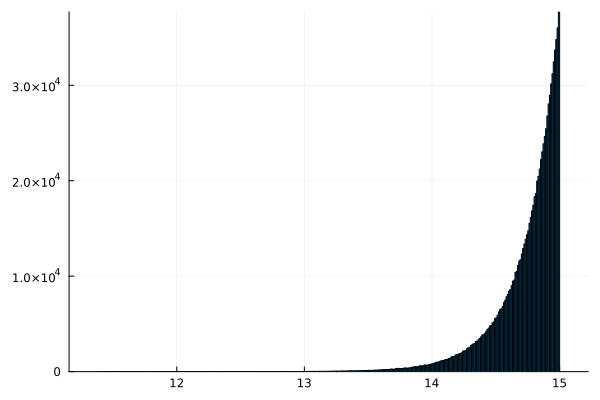

In [329]:
histogram(data, label=false)

In [331]:
f_prime(u) = (1 / (2u-^2)) * exp(-u^2) + exp(-u^2)
x_range = -800:0.1:-790
plot(x_range, f_prime.(x_range))

LoadError: ParseError:
[90m# Error @ [0;0m]8;;file:///Users/uqjnazar/git/TruncatedDistributions.jl/notebooks/In[331]#1:23\[90mIn[331]:1:23[0;0m]8;;\
f_prime(u) = (1 / (2u-[48;2;120;70;70m^[0;0m2)) * exp(-u^2) + exp(-u^2)
[90m#                     ╙ ── [0;0m[91mnot a unary operator[0;0m

In [295]:
root2pi = √(2π);
uni_sd = (b-a)/√12
@show uni_sd
μ̂, σ̂ = 0.0, 1.0;
f(x, μ, σ) = exp(-0.5*(x-μ)^2/σ^2)/σ/root2pi
Φ(x) = cdf(Normal(), x)
ϕf(x) = pdf(Normal(), x)
tp(μ,σ) = Φ((b-μ)/σ) - Φ((a-μ)/σ)
α(μ,σ) = (a - μ)/σ
β(μ,σ) = (b - μ)/σ
ϕΦr(μ,σ) = (ϕf(β(μ, σ)) - ϕf(α(μ, σ)))/(Φ(β(μ, σ)) - Φ(α(μ, σ)))
ϕΦr2(μ,σ) = (β(μ, σ)*ϕf(β(μ, σ)) - α(μ, σ)ϕf(α(μ, σ)))/(Φ(β(μ, σ)) - Φ(α(μ, σ)))
mm(μ, σ) = μ - σ*ϕΦr(μ,σ);
sd(μ, σ) = σ*√(1 - ϕΦr2(μ,σ) - ϕΦr(μ,σ)^2 );

uni_sd = 1.277933507432885


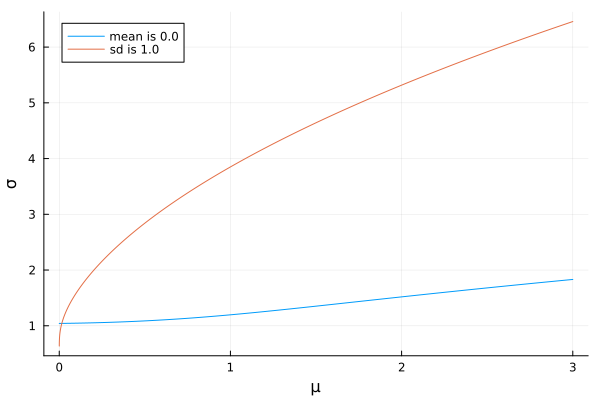

In [14]:
sig_of_μ_4mean(μ) = find_zero((σ)->mm(μ, σ),[0.1,300]);
sig_of_μ_4sd(μ) = find_zero((σ)->(sd(μ, σ)-σ̂),[0.1,300]);
μ_range = 0.0001:0.0001:3
σ_values4sd = sig_of_μ_4mean.(μ_range)
σ_values4mean = sig_of_μ_4sd.(μ_range)
plot(μ_range, [σ_values4mean σ_values4sd], xlabel = "μ", ylabel="σ",label=["mean is $μ̂" "sd is $σ̂"])#, ylim=(0,5))

In [15]:
best_index = findmin(abs, σ_values4sd - σ_values4mean)[2]
μ = μ_range[best_index]
σ = mean([σ_values4mean[best_index], σ_values4sd[best_index]])
@show μ, σ;

(μ, σ) = (0.015, 1.0431904311398572)


uni_sd = 1.5488865403477594
sum(y_vals * δ) = 1.0000043185856522
(sum((x_range .* y_vals) * δ), mm(μ, σ), mean(dist)) = (-2.729810268442545e-6, 9.659537135593352e-6, 9.659537135593352e-6)
(√(sum(((x_range .- mm(μ, σ)) .^ 2 .* y_vals) * δ)), sd(μ, σ), std(dist)) = (1.0001058491808357, 1.0000881717863757, 1.0000881717863757)
tp(μ, σ) = 0.9885773463103594


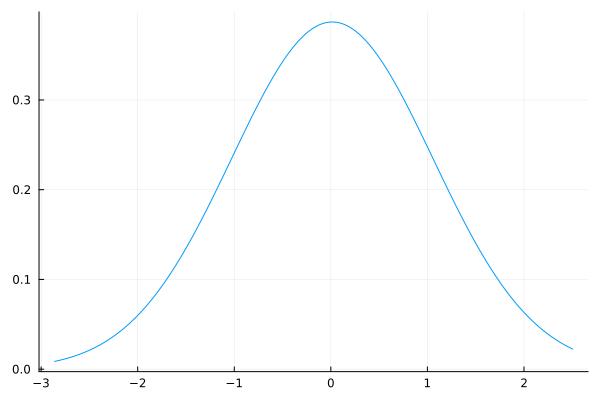

In [16]:
uni_sd = (b-a)/√12
@show uni_sd
δ = 0.001
x_range = a:δ:b
y_vals = [f(x, μ, σ)/tp(μ, σ) for x in x_range]
dist = TruncatedNormal(μ, σ, a, b)
@show sum(y_vals*δ)
@show sum(x_range .* y_vals*δ), mm(μ, σ), mean(dist)
@show √sum((x_range .- mm(μ,σ)).^2 .* y_vals*δ), sd(μ, σ), std(dist)
@show tp(μ, σ)
plot(x_range,y_vals,label=false)

In [17]:
μ*σ̂_original + μ̂_original, σ*σ̂_original

(12.680006896564791, 0.9721278165723678)

# Trying a mapping

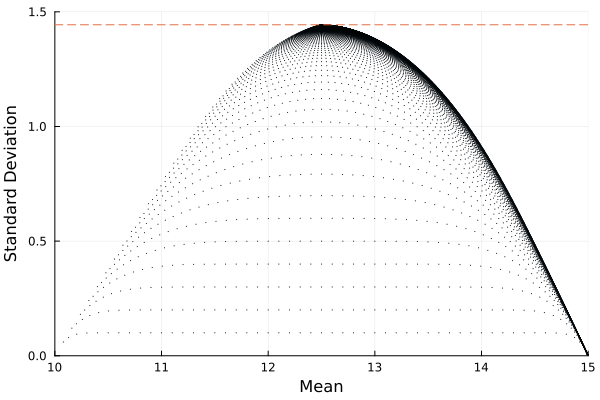

In [34]:
a, b = 10, 15
μ_grid = 10:0.1:30
σ_grid = 0.1:0.1:20
μ̂_vals = Float64[]
σ̂_vals = Float64[]
for μ ∈ μ_grid
    for σ ∈ σ_grid
        # μ = rand(Uniform(extrema(μ_grid)...))
        # σ = rand(Uniform(extrema(σ_grid)...))
        dist = TruncatedNormal(μ, σ, a, b);
        μ̂, σ̂ = mean(dist), std(dist)
        push!(μ̂_vals, μ̂)
        push!(σ̂_vals, σ̂)
    end
end

# adjust_envelope = false
# if adjust_envelope
#     points = [x for x in zip(μ̂_vals, σ̂_vals)]
#     points = filter((x)->(x[1] > 12.5), points)
#     sort!(points, by = first,rev=true)
#     mu_pts = first.(points)
#     sig_pts = last.(points);
#     envelope = [x for x in zip(mu_pts, accumulate(max,sig_pts))];
# end

scatter(μ̂_vals, σ̂_vals, label = false, ms = 0.2, xlabel = "Mean", ylabel = "Standard Deviation", xlim = (10,15), ylim = (0,1.5))
hline!([(15-10)/√12], label=false, linestyle=:dash)
# plot!(envelope, label = false, c=:red, lw=3)

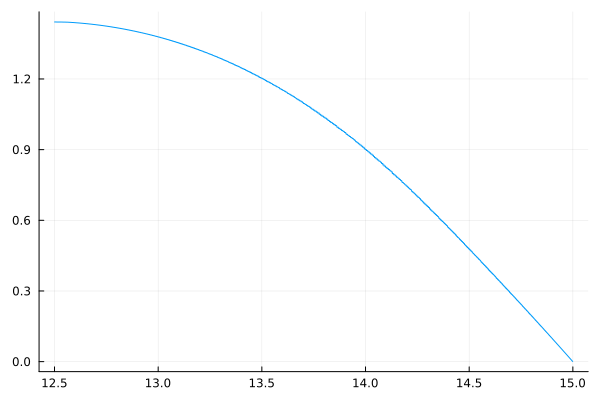

In [221]:
plot(envelope, label = false)

$$
P(X < u) = 1- \frac{1}{2u}e^{-u^2}
$$

In [7]:
using Distributions, Plots

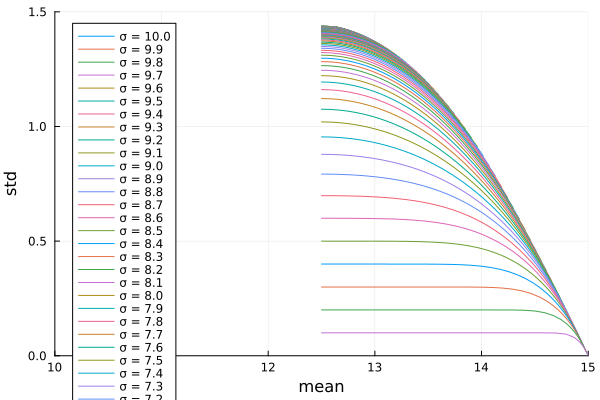

In [67]:
plt = plot()
for σ ∈ 10:-0.1:0.1
    mean_vals, std_vals = [], []
    for μ in 12.5:0.1:20
        d = TruncatedNormal(μ, σ, 10, 15)
        m, s = mean(d), std(d)
        # @show μ, m, s
        push!(mean_vals, m)
        push!(std_vals, s)
    end
    plot!(plt, mean_vals,std_vals, xlim = (10,15),ylim=(0,1.5), 
            label = "σ = $σ", 
            ms = 2.5, 
            lw=1,
            legend=:topleft,
            xlabel="mean", ylabel="std")
end
plt